<a href="https://colab.research.google.com/github/Kalazclint/River_gage_height_forecasting/blob/main/Wavenet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
path = '/content/drive/My Drive/dataset_2015_2020.xlsx'
data = pd.read_excel(path)
data.head()

,Date/Time,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
0,2015-01-01 00:00:00-06:00,13.79,1.91,17.87,1.70
1,2015-01-01 00:15:00-06:00,13.79,1.91,17.85,1.71
2,2015-01-01 00:30:00-06:00,13.79,1.90,17.86,1.72
3,2015-01-01 00:45:00-06:00,13.79,1.90,17.85,1.72
4,2015-01-01 01:00:00-06:00,13.79,1.90,17.85,1.72


In [ ]:
data['Date/Time'] = pd.to_datetime(data['Date/Time'])

In [ ]:
#Resetting Index to Date data
data.set_index('Date/Time', inplace=True)

In [ ]:
data.head()


,gage_height_ft_sensor_07377600,gage_height_ft_sensor_07377760,gage_height_ft_sensor_07378050,gage_height_ft_sensor_07380120
Date/Time,,,,
2015-01-01 00:00:00-06:00,13.79,1.91,17.87,1.70
2015-01-01 00:15:00-06:00,13.79,1.91,17.85,1.71
2015-01-01 00:30:00-06:00,13.79,1.90,17.86,1.72
2015-01-01 00:45:00-06:00,13.79,1.90,17.85,1.72
2015-01-01 01:00:00-06:00,13.79,1.90,17.85,1.72


In [ ]:
#Data Splitting
percentage = 0.8
splitting_time = int(len(data) * percentage)

train_x = np.array(data.values[:splitting_time],dtype=np.float32)
val_x = np.array(data.values[splitting_time:],dtype=np.float32)

print("train dataset size : %d" %len(train_x))
print("validation dataset size : %d" %len(val_x))

train dataset size : 168344
validation dataset size : 42087


In [ ]:
# Construction of the series

train_x = tf.convert_to_tensor(train_x)
test_x = tf.convert_to_tensor(val_x)

scaler = preprocessing.MinMaxScaler()
scaler.fit(train_x)

train_x_norm = scaler.transform(train_x)
val_x_norm = scaler.transform(val_x)

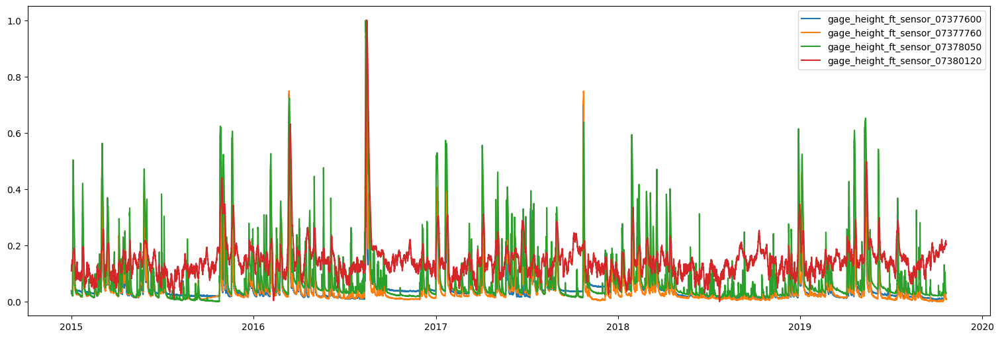

In [ ]:
# Displaying some scaled series
cols = list(data.columns)

fig, ax = plt.subplots(constrained_layout=True, figsize=(15,5))
for i in range(4):
  ax.plot(data.index[:splitting_time].values,train_x_norm[:,i], label= cols[i])
ax.legend()
plt.show()

# **Model Architecture**

In [ ]:
def model_wavenet_timeseries(len_seq, len_out, dim_exo, nb_filters, dim_filters, dilation_depth, use_bias, res_l2, final_l2,batch_size):
  input_shape_exo = tf.keras.Input(shape=(len_seq, dim_exo), name='input_exo')
  input_shape_target = tf.keras.Input(shape=(len_seq, 1), name='input_target')

  input_exo = input_shape_exo
  input_target = input_shape_target

  outputs = []

  # 1st loop: I'll be making multi-step predictions (every prediction will serve as input for the second prediction, when I move the window size...).
  for t in range(len_out):

    # Causal convolution for the 1st input: exogenous series
    # out_exo : (batch_size,len_seq,dim_exo)
    out_exo = K.temporal_padding(input_exo, padding=((dim_filters - 1), 0)) #To keep the same len_seq for the hidden layers
    out_exo = tf.keras.layers.Conv1D(filters=nb_filters, kernel_size=dim_filters,dilation_rate=1,use_bias=True,activation=None,
                              name='causal_convolution_exo_%i' %t, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(out_exo)

    # Causal convolution for the 2nd input: target series
    # out_target : (batch_size,len_seq,1)
    out_target = K.temporal_padding(input_target, padding=((dim_filters - 1), 0))#To keep the same len_seq for the hidden layers
    out_target = tf.keras.layers.Conv1D(filters=nb_filters, kernel_size=dim_filters,dilation_rate=1,use_bias=True,activation=None,
                              name='causal_convolution_target_%i' %t, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(out_target)

    # Frist Layer #1 (See visual Above)
    # Dilated Convolution (1st Layer #1): part of exogenous series(see visual above)
    # skip_exo : (batch_size,len_seq,dim_exo)
    # first_out_exo (the same as skip_exo, before adding the residual connection): (batch_size, len_seq, dim_exo)
    skip_outputs = []
    z_exo = K.temporal_padding(out_exo, padding=(2*(dim_filters - 1), 0))
    z_exo = tf.keras.layers.Conv1D(filters=nb_filters,kernel_size=dim_filters,dilation_rate=2,use_bias=True,activation="relu",
                              name='dilated_convolution_exo_1_%i' %t, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z_exo)

    skip_exo = tf.keras.layers.Conv1D(dim_exo, 1, padding='same', use_bias=False, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z_exo)
    first_out_exo = tf.keras.layers.Conv1D(dim_exo, 1, padding='same', use_bias=False, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z_exo)

    # Dilated Convolution (1st Layer #1): part of target series(see visual above)
    # skip_target : (batch_size,len_seq,1)
    # first_out_target (the same as skip_target, before adding the residual connection): (batch_size, len_seq,1)
    z_target = K.temporal_padding(out_target, padding=(2*(dim_filters - 1), 0))
    z_target = tf.keras.layers.Conv1D(filters=nb_filters,kernel_size=dim_filters,dilation_rate=2,use_bias=True,activation="relu",
                              name='dilated_convolution_target_1_%i' %t, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z_target)
    skip_target = tf.keras.layers.Conv1D(1, 1, padding='same', use_bias=False, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z_target)
    first_out_target = tf.keras.layers.Conv1D(1, 1, padding='same', use_bias=False, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z_target)

    # Concatenation of the skip_exo & skip_target AND Saving them as we go through the 1st for loop (through len_seq)
    # skip_exo : (batch_size,len_seq,dim_exo)
    # skip_target : (batch_size,len_seq,1)
    # The concatenation of skip_exp & skip_target : (batch_size,len_seq,dim_exo+1)
    skip_outputs.append(tf.concat([skip_exo,skip_target],axis=2))

    # Adding the Residual connections of the exogenous series & target series to inputs
    # res_exo_out : (batch_size,len_seq,dim_exo)
    # res_target_out : (batch_size,len_seq,1)
    res_exo_out = tf.keras.layers.Add()([input_exo, first_out_exo])
    res_target_out = tf.keras.layers.Add()([input_target, first_out_target])

    # Concatenation of the updated outputs (after having added the residual connections)
    # out_concat : (batch_size,len_seq,dim_exo+1)
    out_concat = tf.concat([res_exo_out, res_target_out],axis=2)
    out = out_concat

    # From 2nd Layer Layer#2 to Final Layer (Layer #L): See Visual above
    # 2nd loop: inner loop (Going through all the intermediate layers)
    # Intermediate dilated convolutions
    for i in range(2, dilation_depth + 1):
      z = K.temporal_padding(out_concat, padding=(2**i * (dim_filters - 1), 0)) # To keep the same len_seq
      z = tf.keras.layers.Conv1D(filters=nb_filters,kernel_size=dim_filters,dilation_rate=2**i,use_bias=True,activation="relu",
                              name='dilated_convolution_%i_%i' %(i,t), kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z)

      skip_x = tf.keras.layers.Conv1D(dim_exo+1, 1, padding='same', use_bias=False, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z)
      first_out_x = tf.keras.layers.Conv1D(dim_exo+1, 1, padding='same', use_bias=False, kernel_regularizer=tf.keras.regularizers.l2(res_l2))(z)

      res_x = tf.keras.layers.Add()([out, first_out_x])  #(batch_size,len_seq,dim_exo+1)
      out = res_x
      skip_outputs.append(skip_x)                        #(batch_size,len_seq,dim_exo+1)

    # Adding intermediate outputs of all the layers (See Visual above)
    out = tf.keras.layers.Add()(skip_outputs)            #(batch_size,len_seqe,dim_exo+1)

    # Output Layer (exogenous series & target series)
    # outputs : (batch_size,1,1) # The predcition Y
    # out_f_exo (will be used to Adjust the input for the following prediction, see below) : (batch_size,len_seq,dim_exo)
    out = tf.keras.layers.Activation('linear', name="output_linear_%i" %t)(out)
    out_f_target = tf.keras.layers.Conv1D(1, 1, padding='same', kernel_regularizer=tf.keras.regularizers.l2(final_l2))(out)
    out_f_exo = tf.keras.layers.Conv1D(dim_exo, 1, padding='same', kernel_regularizer=tf.keras.regularizers.l2(final_l2))(out)
    outputs.append(out_f_target[:,-1:,:])

    # Adjusting the entry of exogenous series,for the following prediction (of MultiStep predictions): see the 1st loop
    # First: concatenate the previous exogenous series input with the final exo_prediction(current exo_prediction)
    input_exo = tf.concat([input_exo, out_f_exo[:,-1:,:]],axis=1)
    # Second, shift the moving window (of len_seq size) by one
    input_exo = tf.slice(input_exo,[0,1,0],[batch_size,input_shape_exo.shape[1],dim_exo])

    # Adjusting the entry of target series,for the following prediction (of MultiStep predictions): see the 1st loop
    # First: concatenate the previous target series input with the final prediction(current prediction)
    input_target = tf.concat([input_target,out_f_target[:,-1:,:]],axis=1)
    # Second, shift the moving window (of len_seq size) by one
    input_target = tf.slice(input_target,[0,1,0],[batch_size,input_shape_target.shape[1],1])

  outputs = tf.convert_to_tensor(outputs)             # (len_out,batch_size,1,1)
  outputs = tf.squeeze(outputs,-1)                    # (len_out,batch_size,1)
  outputs = tf.transpose(outputs,perm=[1,0,2])        # (batch_size,len_out,1)

  model = tf.keras.Model([input_shape_exo,input_shape_target], outputs)
  return model

In [ ]:
def compute_len_seq(dilation_depth):
  return (2 ** dilation_depth * 2)

In [ ]:
nb_filters = 96
dim_filters = 2
dilation_depth = 4
use_bias = False
res_l2 = 0
final_l2 = 0

batch_size = 128
len_out = 5
dim_exo = 3

len_seq = compute_len_seq(dilation_depth)
print(len_seq)

model = model_wavenet_timeseries(len_seq, len_out, dim_exo, nb_filters, dim_filters, dilation_depth, use_bias, res_l2, final_l2,batch_size=batch_size)
model.summary()

32
Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_exo (InputLayer)         [(None, 32, 3)]      0           []                               
                                                                                                  
 input_target (InputLayer)      [(None, 32, 1)]      0           []                               
                                                                                                  
 tf.compat.v1.pad_280 (TFOpLamb  (None, 33, 3)       0           ['input_exo[0][0]']              
 da)                                                                                              
                                                                                                  
 tf.compat.v1.pad_281 (TFOpLamb  (None, 33, 1)       0           ['input_target[0][0]']  

## **Data Preparation**

In [ ]:
def prepare_dataset_XY(seriesx, seriesy, len_seq, len_out, batch_size,shift):
  '''
  A function for creating a dataset from time series data as follows:
  X = {((X1_1,X1_2,...,X1_T),(X2_1,X2_2,...,X2_T),(X3_1,X3_2,...,X3_T)),
       (Y1,Y2,...,YT)}
  Y = YT+1
  seriesx-- Exogenous series, shape: (Tin, number_of_exogenous_series) with Tin: length of the time series
  seriesy-- Target series, shape: (Tin, 1)
  len_seq-- Sequence length: integer
  len_out-- Length of the predicted sequence (output): integer
  shift-- The window offset: integer
  batch_size-- Size of the batch: integer

  '''
  # Exogenous series
  # ((X1_1,X1_2,...,X1_T),(X2_1,X2_2,...,X2_T),(X3_1,X3_2,...,X3_T),....)
  dataset_x = tf.data.Dataset.from_tensor_slices(seriesx)
  dataset_x = dataset_x.window(len_seq+len_out, shift = shift, drop_remainder=True)
  dataset_x = dataset_x.flat_map(lambda x: x.batch(len_seq+len_out))
  dataset_x = dataset_x.map(lambda x: x[0:len_seq][:,:]) # shape:[[ ]]
  dataset_x = dataset_x.batch(batch_size, drop_remainder=True).prefetch(1) # shape: [[[]]] (adding the batch_size)

  # The target series
  # (Y1,Y2,...,YT)
  dataset_y = tf.data.Dataset.from_tensor_slices(seriesy)
  dataset_y = dataset_y.window(len_seq+len_out, shift = shift, drop_remainder=True)
  dataset_y = dataset_y.flat_map(lambda x: x.batch(len_seq+len_out))
  dataset_y = dataset_y.map(lambda x: x[0:len_seq][:,:])
  dataset_y = dataset_y.batch(batch_size, drop_remainder=True).prefetch(1)

  # Y = YT+1 (the values to predict)
  dataset_ypred = tf.data.Dataset.from_tensor_slices(seriesy)
  dataset_ypred = dataset_ypred.window(len_seq+len_out+1, shift=shift, drop_remainder=True)
  dataset_ypred = dataset_ypred.flat_map(lambda x: x.batch(len_seq+len_out+1))
  dataset_ypred = dataset_ypred.map(lambda x: (x[0:len_seq+1][-len_out:,:]))
  dataset_ypred = dataset_ypred.batch(batch_size, drop_remainder=True).prefetch(1)

  dataset = tf.data.Dataset.zip((dataset_x, dataset_y))
  dataset = tf.data.Dataset.zip((dataset, dataset_ypred))
  return dataset

In [ ]:
# The characteristics of the dataset I want to create

batch_size = 128
len_out = 5
len_seq = compute_len_seq(dilation_depth)
shift=1

# Dataset creation
dataset = prepare_dataset_XY(train_x_norm[:,0:-1], train_x_norm[:,-1:], len_seq, len_out, batch_size, shift)
dataset_val = prepare_dataset_XY(val_x_norm[:,0:-1], val_x_norm[:,-1:], len_seq, len_out, batch_size, shift)

In [ ]:
print(len(list(dataset.as_numpy_iterator())))
print(("---------------"))
for element in dataset.take(1):
  print(element[0][0].shape)
  print(element[0][1].shape)
  print(element[1].shape)

1314
---------------
(128, 32, 3)
(128, 32, 1)
(128, 5, 1)


In [ ]:
print(len(list(dataset_val.as_numpy_iterator())))
print(("---------------"))
for element in dataset.take(1):
  print(element[0][0].shape)
  print(element[0][1].shape)
  print(element[1].shape)

328
---------------
(128, 32, 3)
(128, 32, 1)
(128, 5, 1)


In [ ]:
shift = 1
dataset = prepare_dataset_XY(train_x_norm[:, :-1], train_x_norm[:, -1:], len_seq, len_out, batch_size, shift)

X1_train = []
X2_train = []
y_train = []

for x, y in dataset:
    X1_train.append(x[0])
    X2_train.append(x[1])
    y_train.append(y)

X1_train = np.concatenate(X1_train, axis=0)
X2_train = np.concatenate(X2_train, axis=0)
y_train = np.concatenate(y_train, axis=0)

print(X1_train.shape)
print(X2_train.shape)
print(y_train.shape)


(168192, 32, 3)
(168192, 32, 1)
(168192, 5, 1)


In [ ]:
dataset_val = prepare_dataset_XY(val_x_norm[:, :-1], val_x_norm[:, -1:], len_seq, len_out, batch_size, shift)

X1_val = []
X2_val = []
y_val = []

for x, y in dataset_val:
    X1_val.append(x[0])
    X2_val.append(x[1])
    y_val.append(y)

X1_val = np.concatenate(X1_val, axis=0)
X2_val = np.concatenate(X2_val, axis=0)
y_val = np.concatenate(y_val, axis=0)

print(X1_val.shape)
print(X2_val.shape)
print(y_val.shape)


(41984, 32, 3)
(41984, 32, 1)
(41984, 5, 1)


# **Model Training**

In [ ]:
max_periods = 50
lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
    initial_learning_rate=0.005,
    decay_steps=50,
    decay_rate=0.01
)
opt = tf.keras.optimizers.Adam(learning_rate=lr_schedule)
CheckPoint = tf.keras.callbacks.ModelCheckpoint(
    "weights_train.hdf5",
    monitor='loss',
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    mode='auto',
    save_freq='epoch'
)
model.compile(loss="mse", optimizer=opt, metrics="mse")
history = model.fit(
    [X1_train, X2_train],
    y_train,
    validation_data=([X1_val, X2_val], y_val),
    epochs=max_periods,
    verbose=1,
    callbacks=[CheckPoint, tf.keras.callbacks.EarlyStopping(monitor='loss', patience=20)],
    batch_size=batch_size
)


Epoch 1/50
1314/1314 [==============================] - ETA: 0s - loss: 2.0823e-04 - mse: 2.0823e-04
Epoch 1: loss improved from inf to 0.00021, saving model to weights_train.hdf5
1314/1314 [==============================] - 578s 424ms/step - loss: 2.0823e-04 - mse: 2.0823e-04 - val_loss: 4.0745e-06 - val_mse: 4.0745e-06
Epoch 2/50
1314/1314 [==============================] - ETA: 0s - loss: 5.5081e-06 - mse: 5.5081e-06
Epoch 2: loss improved from 0.00021 to 0.00001, saving model to weights_train.hdf5
1314/1314 [==============================] - 542s 413ms/step - loss: 5.5081e-06 - mse: 5.5081e-06 - val_loss: 1.3856e-06 - val_mse: 1.3856e-06
Epoch 3/50
1314/1314 [==============================] - ETA: 0s - loss: 3.1842e-06 - mse: 3.1842e-06
Epoch 3: loss improved from 0.00001 to 0.00000, saving model to weights_train.hdf5
1314/1314 [==============================] - 554s 421ms/step - loss: 3.1842e-06 - mse: 3.1842e-06 - val_loss: 1.0488e-06 - val_mse: 1.0488e-06
Epoch 4/50
1314/1314 [=

In [ ]:
pred_train = model.predict((x_train[0],x_train[1]),verbose=1,batch_size=batch_size)
pred_val = model.predict((x_val[0],x_val[1]),verbose=1,batch_size=batch_size)

328/328 [==============================] - 34s 102ms/step


# **Model Evaluation**

In [ ]:
import plotly.graph_objects as go

shift = len_out
fig = go.FigureWidget()

# Original series of 'Indoor_Temperature_room'
fig.add_trace(go.Scatter(x=data.index,y=train_x_norm [:,-1],line = {'color':'blue', 'width':1}, name= 'gage_height_ft_sensor_07380120_train'))
fig.add_trace(go.Scatter(x=data.index[splitting_time:],y=val_x_norm[:,-1],line = {'color':'green', 'width':1}, name = 'gage_height_ft_sensor_07380120_val' ))

# Dislply the MultiStep predictions (for the train dataset)

preds = []
pred_index = []
step_time = []
step_val = []

max = int(len(pred_train)/len_out)

for i in range(0,max):
  preds.append(tf.squeeze(pred_train[i*len_out,0:shift,:],1))
  pred_index.append(data.index[len_seq + i*len_out:len_seq + (i+1)*len_out])
  step_val.append(pred_train[i*len_out,0,0])
  step_time.append(data.index[len_seq + i*len_out])

preds = tf.convert_to_tensor(preds).numpy()
preds = np.reshape(preds,(preds.shape[0]*preds.shape[1]))

pred_index = np.asarray(pred_index)
pred_index = np.reshape(pred_index,(pred_index.shape[0]*pred_index.shape[1]))

fig.add_trace(go.Scatter(x=pred_index,y=preds, mode='lines', line=dict(color='magenta', width=1), name= 'predicted_gage_height_ft_sensor_07380120_train'))
fig.add_trace(go.Scatter(x=step_time,y=step_val, mode='markers', line=dict(color='black', width=1), name= 'MultiStep_predicted_gage_height_ft_sensor_07380120_train'))


# Dislply the predictions (for the validation dataset)

predsv = []
predv_index = []
stepv_time = []
stepv_val = []
maxv = int(len(pred_val)/len_out)

for i in range(0,maxv):
  predsv.append(tf.squeeze(pred_val[i*len_out,0:shift,:],1))
  predv_index.append(data.index[splitting_time + i*shift+ len_seq:splitting_time+ i*shift+len_seq+len_out])
  stepv_val.append(pred_val[i*len_out,0,0])
  stepv_time.append(data.index[splitting_time + i*shift + len_seq])

predsv = tf.convert_to_tensor(predsv).numpy()
predsv = np.reshape(predsv,(predsv.shape[0]*predsv.shape[1]))
predv_index = np.asarray(predv_index)
predv_index = np.reshape(predv_index,(predv_index.shape[0]*predv_index.shape[1]))

fig.add_trace(go.Scatter(x=predv_index,y=predsv, mode='lines', line=dict(color='yellow', width=1), name= 'predicted_gage_height_ft_sensor_07380120_val'))
fig.add_trace(go.Scatter(x=stepv_time,y=stepv_val, mode='markers', line=dict(color='brown', width=1), name= 'MultiStep_predicted_gage_height_ft_sensor_07380120_val'))


fig.update_xaxes(rangeslider_visible=True)
yaxis=dict(autorange = True,fixedrange= False)
fig.update_yaxes(yaxis)
fig.show()

In [ ]:
train_x_norm_2 = train_x_norm[len_seq:-(train_x_norm[len_seq:,:].shape[0]-preds.shape[0]),:]
train_x_norm_2_s = scaler.inverse_transform(train_x_norm_2)

gage_height_ft_sensor_07380120_real = train_x_norm_2_s[:,-1]
gage_height_ft_sensor_07380120_real

array([2.04999995, 2.04999995, 2.04999995, ..., 3.51999998, 3.51999998,
       3.50999999])

In [ ]:
train_x_norm_preds = train_x_norm_2.copy()
train_x_norm_preds[:,-1] = preds
train_x_norm_preds_s = scaler.inverse_transform(train_x_norm_preds)

gage_height_ft_sensor_07380120_preds = train_x_norm_preds_s[:,-1]
gage_height_ft_sensor_07380120_preds

array([1.99009514, 1.99810033, 2.01383113, ..., 3.50517467, 3.50666572,
       3.50753396])

In [ ]:
preds = []
pred_index = []
step_time = []
step_val = []

max = int(len(pred_train)/len_out)
for i in range(0,max):
  preds.append(tf.squeeze(pred_train[i*len_out,0:shift,:],1))
preds = tf.convert_to_tensor(preds).numpy()
preds = np.reshape(preds,(preds.shape[0]*preds.shape[1]))

train_x_norm_2 = train_x_norm[len_seq:-(train_x_norm[len_seq:,:].shape[0]-preds.shape[0]),:]
mse_train = tf.keras.losses.mse(train_x_norm_2[:,-1],preds)
print( f"MSE on the train dataset is: {mse_train.numpy()}")

MSE on the train dataset is: 4.1865728235279676e-06


In [ ]:
predsv = []
maxv = int(len(pred_val)/len_out)
for i in range(0,maxv):
  predsv.append(tf.squeeze(pred_val[i*len_out,0:shift,:],1))

predsv = tf.convert_to_tensor(predsv).numpy()
predsv = np.reshape(predsv,(predsv.shape[0]*predsv.shape[1]))

val_x_norm_2 = val_x_norm[len_seq:-(val_x_norm[len_seq:,:].shape[0]-predsv.shape[0]),:]
mse_val = tf.keras.losses.mse(val_x_norm_2[:,-1],predsv)
print( f"MSE on the validation dataset is: {mse_val.numpy()}")

MSE on the validation dataset is: 3.9424567148671485e-06


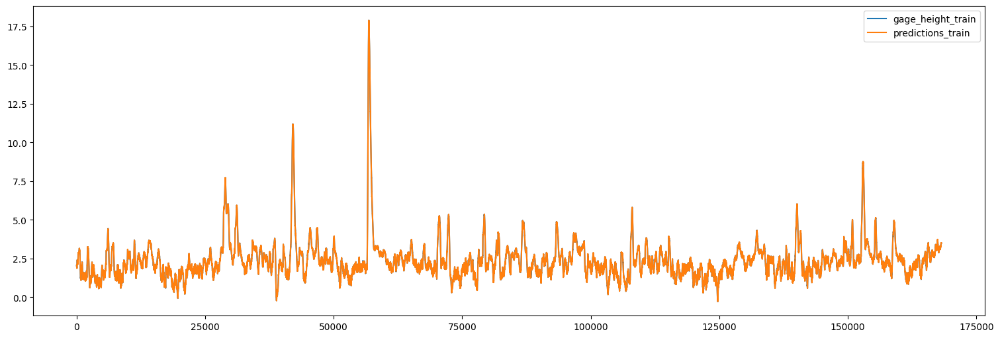

In [ ]:
df_2 = pd.DataFrame({'gage_height_train':gage_height_ft_sensor_07380120_real,'predictions_train':gage_height_ft_sensor_07380120_preds})

fig, ax = plt.subplots(constrained_layout=True, figsize=(15,5))
for i in range(2):
  ax.plot(df_2.index.values,df_2.values[:,i], label= list(df_2.columns)[i])
ax.legend()
plt.show()